# Initialization

In [1]:
import tensorflow as tf
import cv2
import glob
import matplotlib.pyplot as plt


2024-07-08 16:50:26.001562: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
import configs
from ActMapGen import *

# Data Loader

In [ ]:
class MyDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, data_dir, batch_size=32, shuffle=True):
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.filenames = glob.glob(data_dir + '/*/*.jpg')
        self.filenames.sort()
        print(len(self.filenames), 'found')
        self.classnames = ['/akiec/', '/bcc/', '/bkl/',
                           '/df/', '/mel/', '/nv/', '/vasc/']
        self.indices = None
        self.on_epoch_end()

    def __len__(self):
        return int(np.ceil(len(self.filenames) / self.batch_size))

    def __getitem__(self, index):
        indices = self.indices[index*self.batch_size:(index+1)*self.batch_size]
        filenames = [self.filenames[k] for k in indices]
        X, Y = self.__data_generation(filenames)
        return X, Y

    def on_epoch_end(self):
        self.indices = np.arange(len(self.filenames))
        if self.shuffle == True:
            np.random.shuffle(self.indices)

    def filename2onehot(self, fn):
        for i in range(configs.NUM_CLASS):
            if self.classnames[i] in fn:
                result = np.zeros(configs.NUM_CLASS, dtype=np.float64)
                result[i] = 1
                return result
        return None

    def __data_generation(self, filenames):
        num = len(filenames)
        X = np.empty([num, *configs.IMAGE_SIZE], dtype=np.float64)
        Y_class = np.empty([num, configs.NUM_CLASS])
        for i, fn in enumerate(filenames):
            img = cv2.imread(fn)
            delta = (configs.IMAGE_SIZE[1] - configs.IMAGE_SIZE[0]) // 2
            img = img[:, delta:configs.IMAGE_SIZE[1]-delta-1]
            img = cv2.resize(img, (224, 224))
            X[i] = np.array(img, dtype=np.float64) / 255.
            Y_class[i] = self.filename2onehot(fn)

        return X, {'out_img':X, 'out_class':Y_class}

In [ ]:
train_datagen = MyDataGenerator(configs.DATA_DIR+'/train', shuffle=False)
val_datagen = MyDataGenerator(configs.DATA_DIR+'/val', shuffle=False)
test_datagen = MyDataGenerator(configs.DATA_DIR+'/test', shuffle=False)

5005 found


# Activation Map Generation - Pixel-wise

In [ ]:
classifier = tf.keras.models.load_model(configs.CLASSIFIER_CHECKPOINT)

In [ ]:
def compute_pixel_weights(img, gen_img):
  weights = np.sum(np.array(img - gen_img)**2, axis=2)
  weights /= np.max(weights)
  return weights

def confidence_diff(prediction_proba, prediction_proba_gen, label):
  return (prediction_proba[label] - prediction_proba_gen[label])**2

def random_toggle_pixels(img):
  h, w, c = img.shape
  mask = np.random.randint(2, size=[h, w])
  mask = np.dstack([mask] * 3)
  return mask * img

def generate_activation_map(img, label, classifier, num_trial=16):
  activation_map = np.zeros(img.shape[:2])
  prediction_proba = classifier.predict(np.array([img]), verbose=0)[0]

  for i in range(num_trial):
    output_img = random_toggle_pixels(img)

    px_weights = compute_pixel_weights(img, output_img)
    prediction_proba_gen = classifier.predict(np.array([output_img]), verbose=0)[0]
    activation_map += px_weights * confidence_diff(prediction_proba,
                                                   prediction_proba_gen,
                                                   label)

    plt.subplot(1, 2, 1)
    plt.axis('off')
    plt.imshow(cv2.cvtColor((img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
    plt.subplot(1, 2, 2)
    plt.axis('off')
    plt.imshow(cv2.cvtColor((output_img*255).astype(np.uint8), cv2.COLOR_BGR2RGB))
    plt.show()

  return activation_map

In [ ]:
X, Y = test_datagen[0]
print(X.shape, Y.shape)

(32, 224, 224, 3) (32, 7)


# Generating

In [ ]:
def run(index):
  label = Y[index].argmax()
  print(index, label)
  img = X[index]
  activation_map = generate_activation_map(img, label, classifier)
  print(activation_map.shape)
  plt.imshow(activation_map)
  plt.show()

0 0


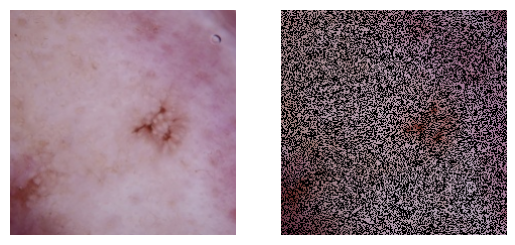

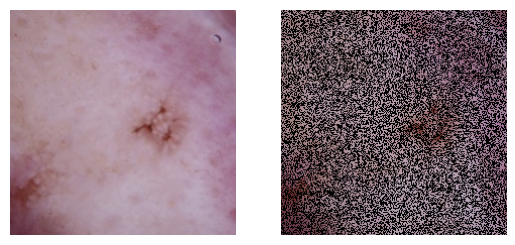

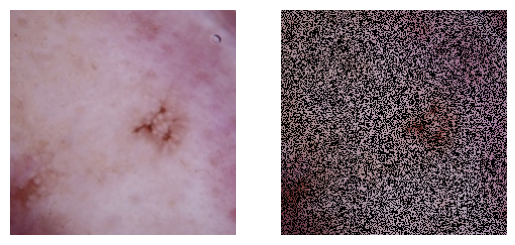

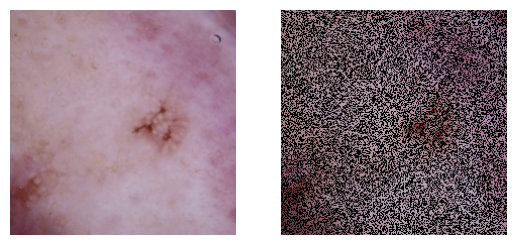

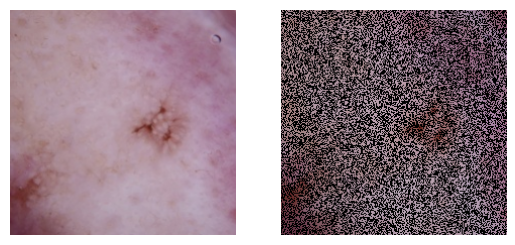

...

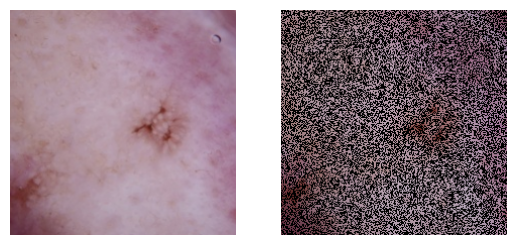

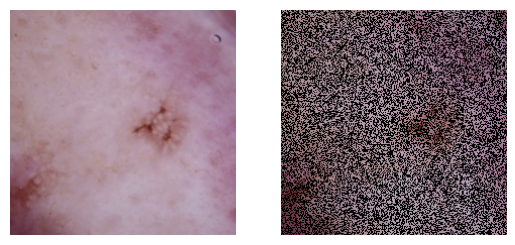

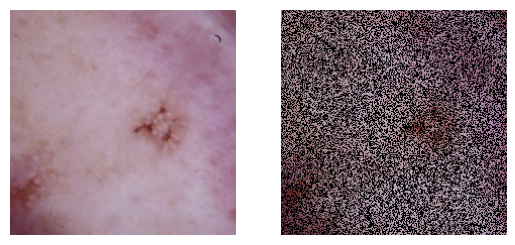

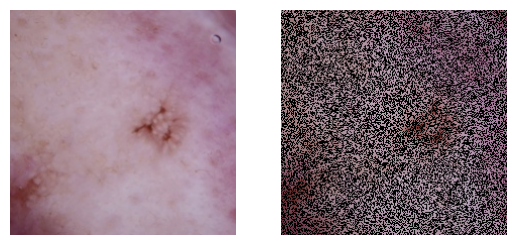

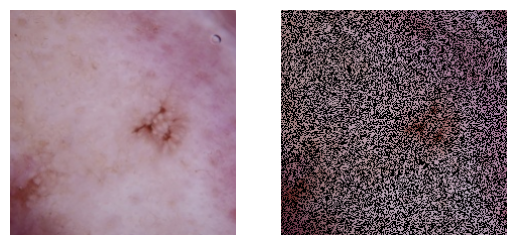

(224, 224)


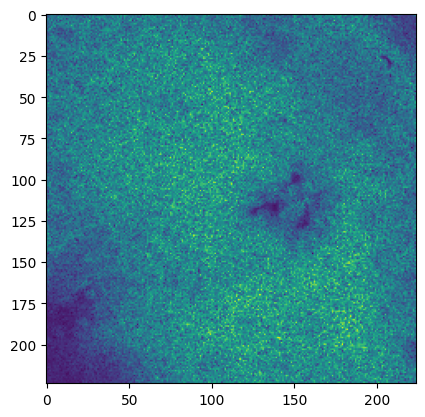

5 0


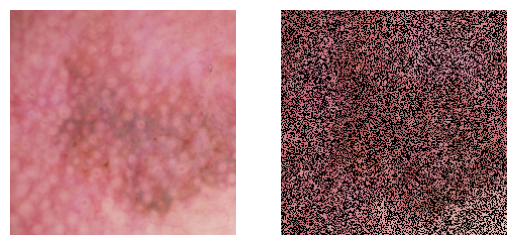

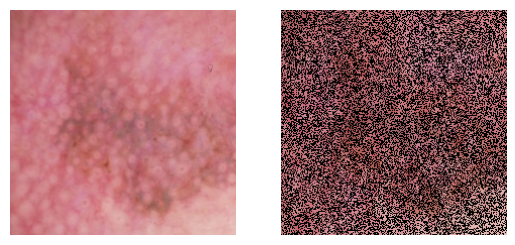

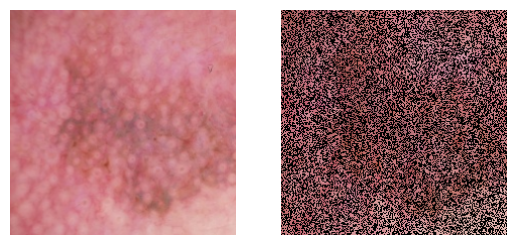

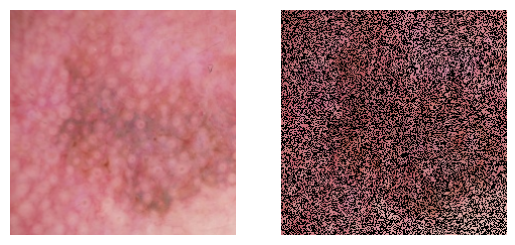

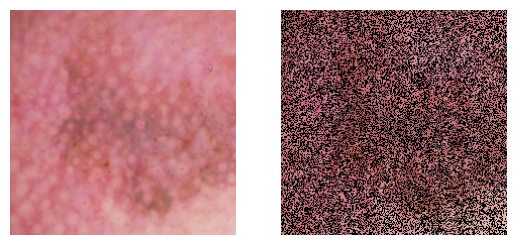

...

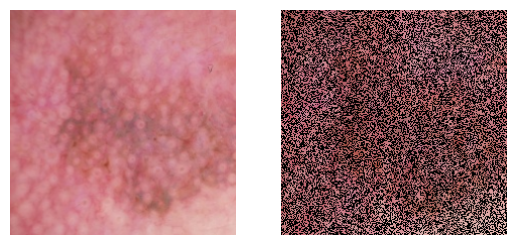

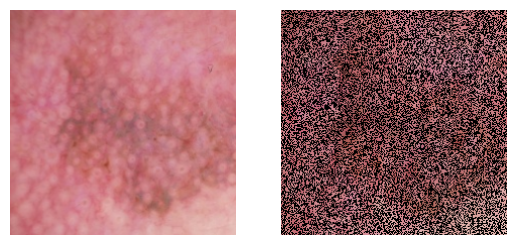

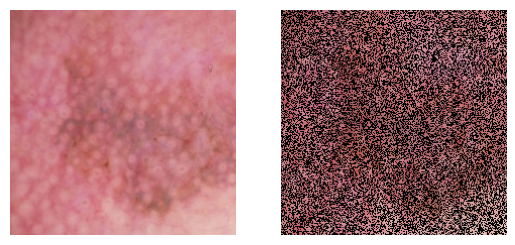

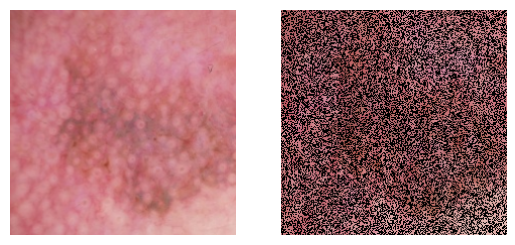

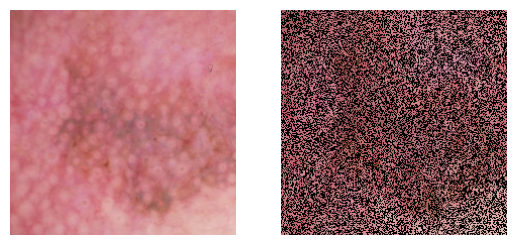

(224, 224)


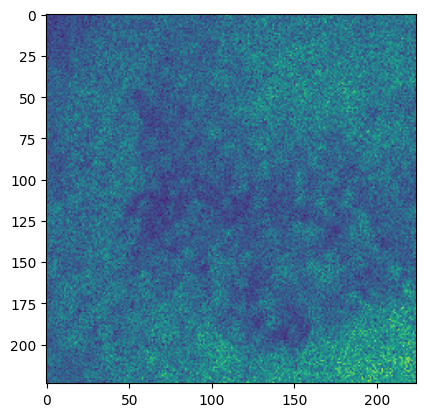

10 0


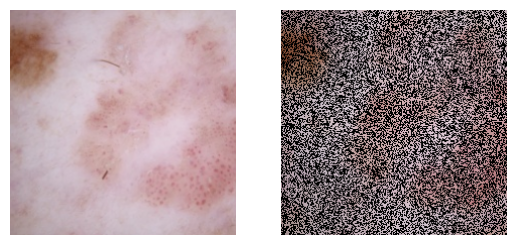

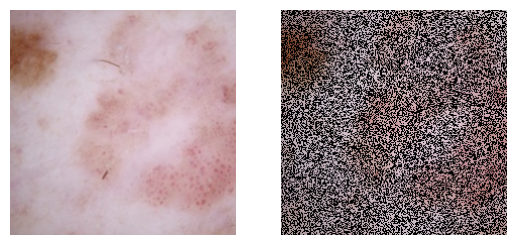

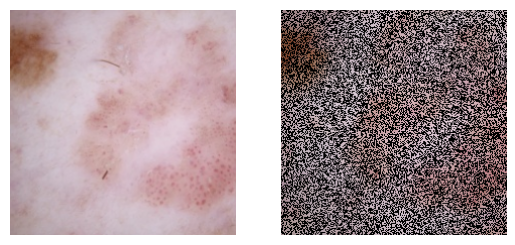

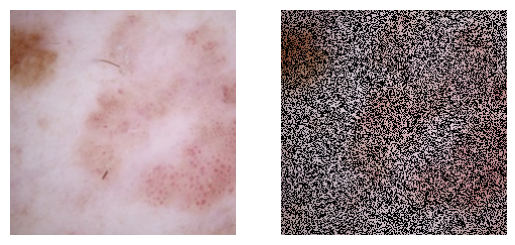

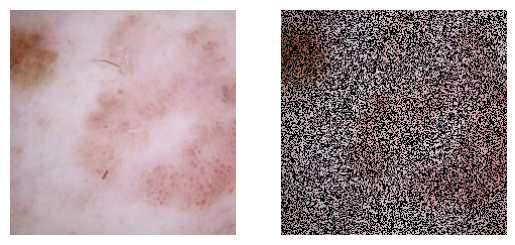

...

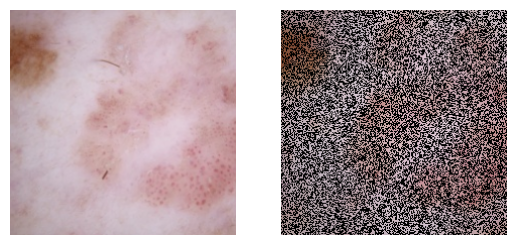

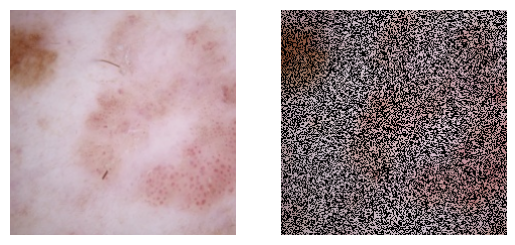

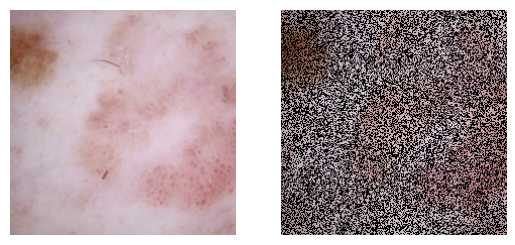

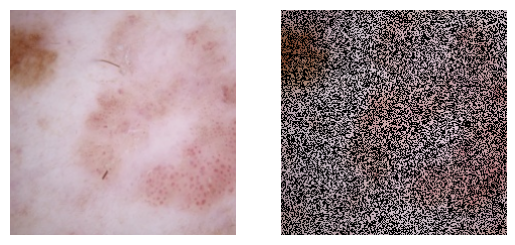

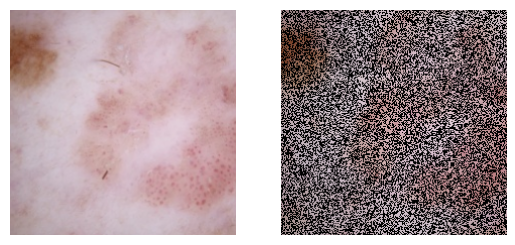

(224, 224)


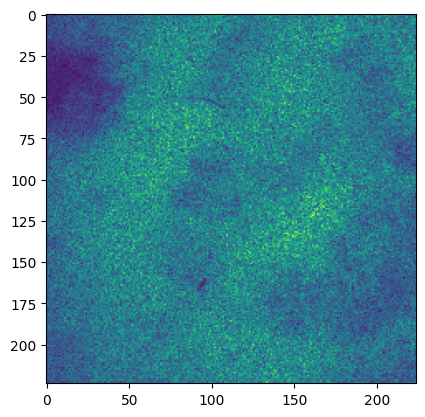

15 0


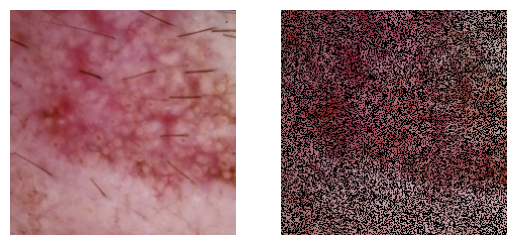

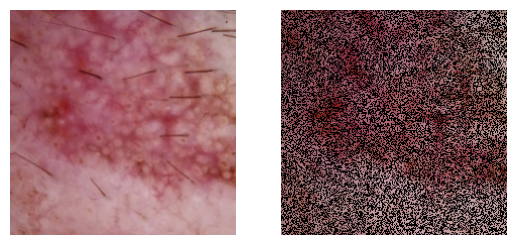

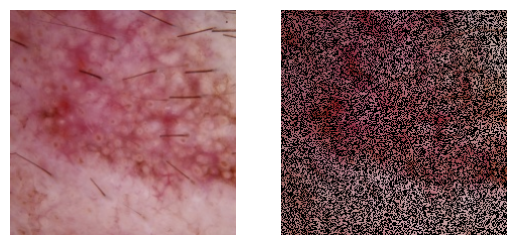

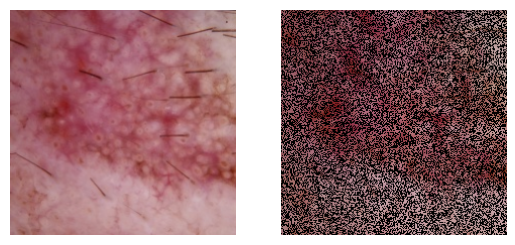

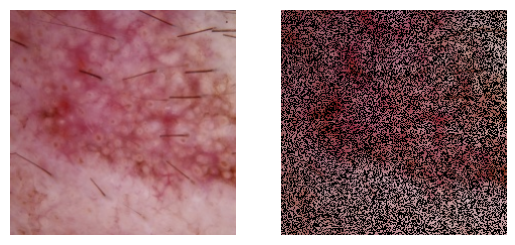

...

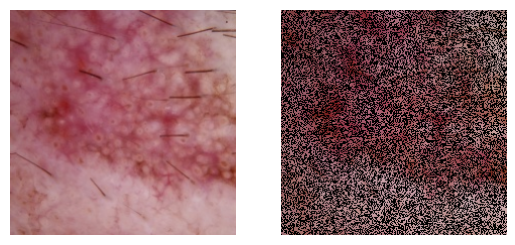

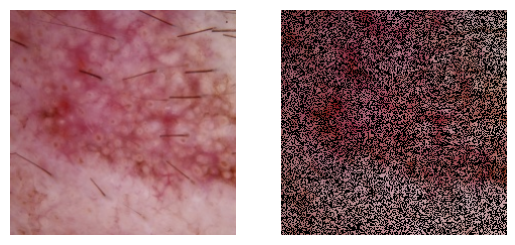

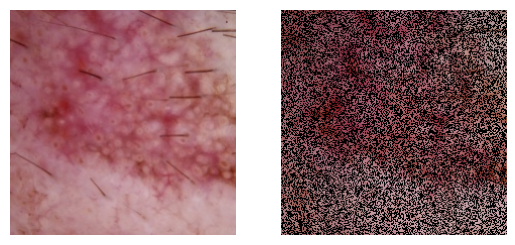

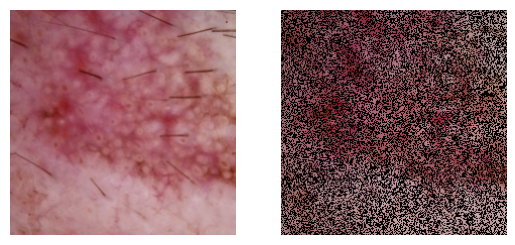

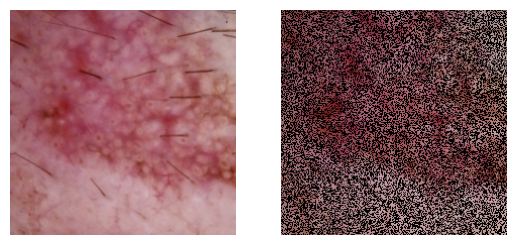

(224, 224)


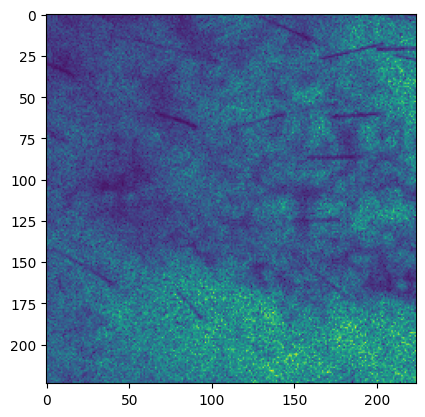

20 0


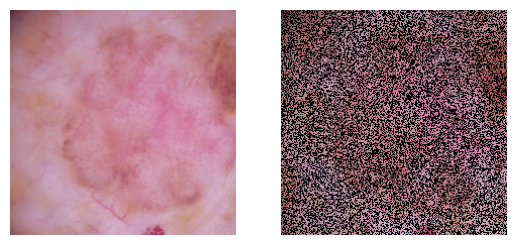

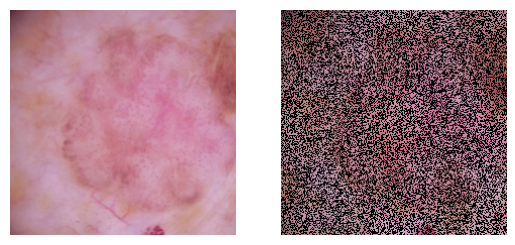

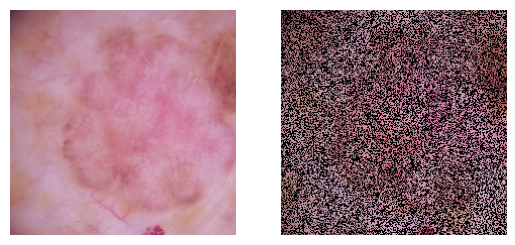

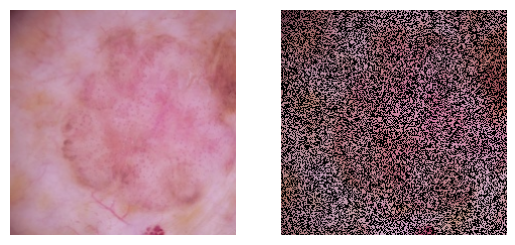

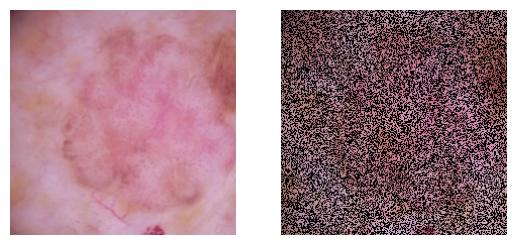

...

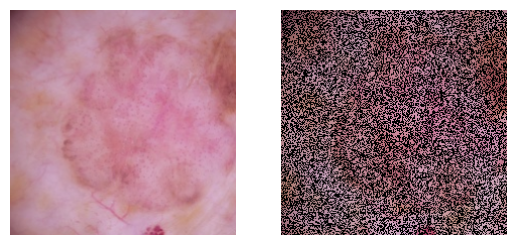

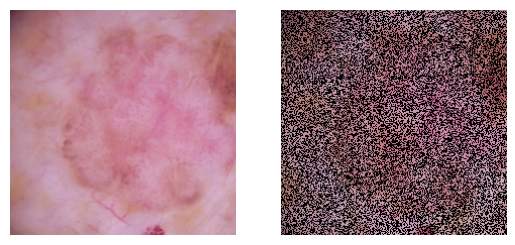

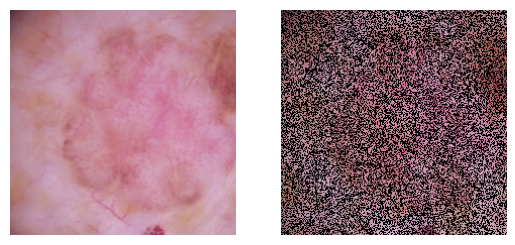

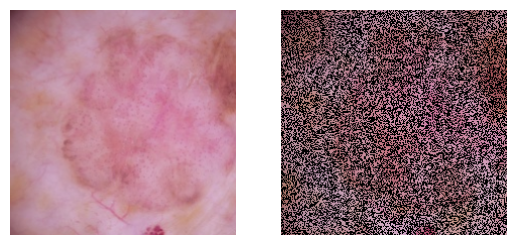

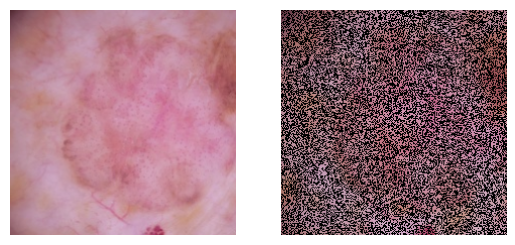

(224, 224)


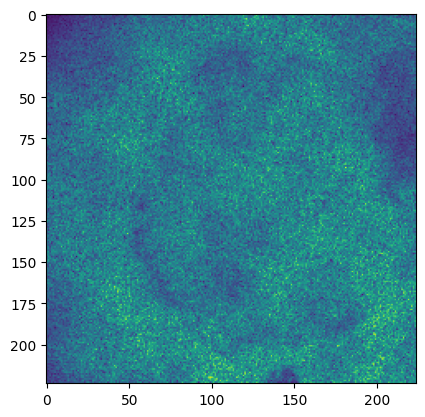

25 0


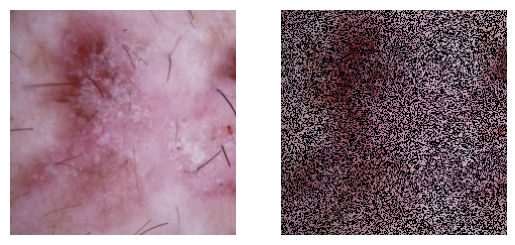

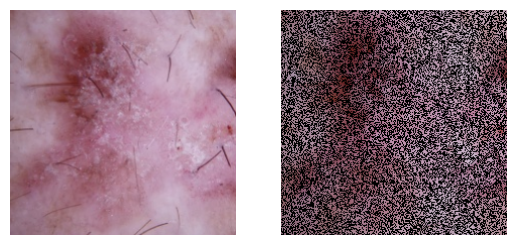

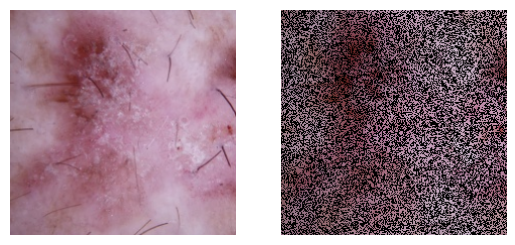

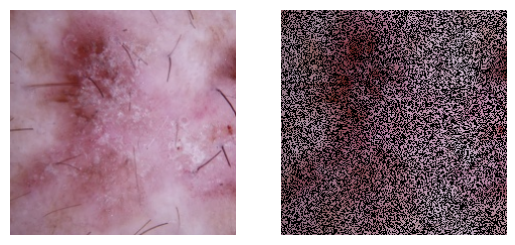

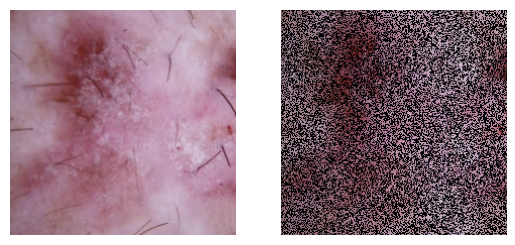

...

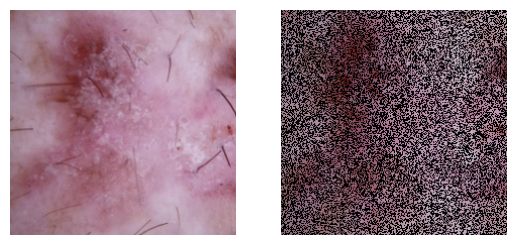

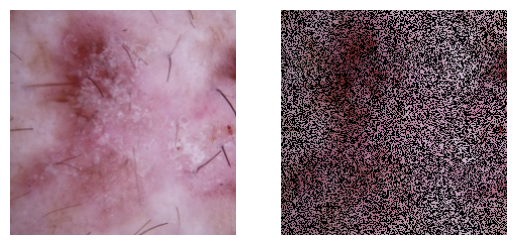

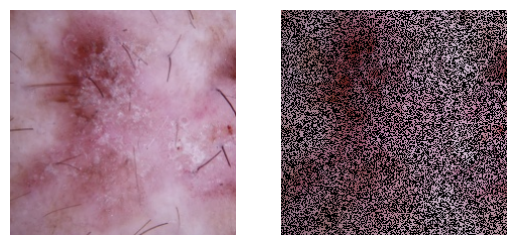

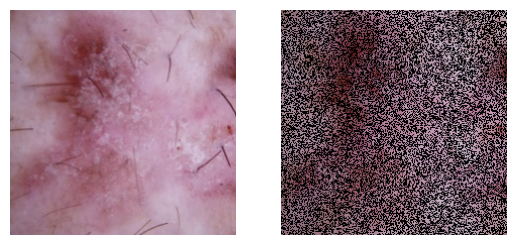

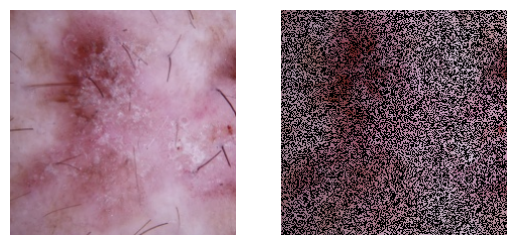

(224, 224)


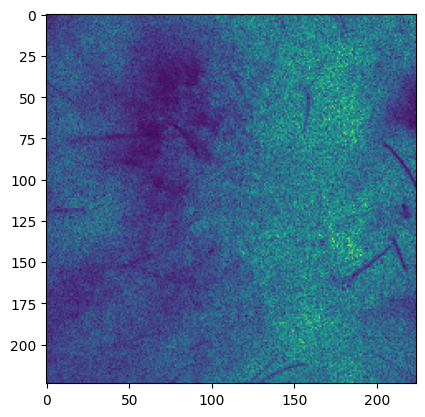

30 0


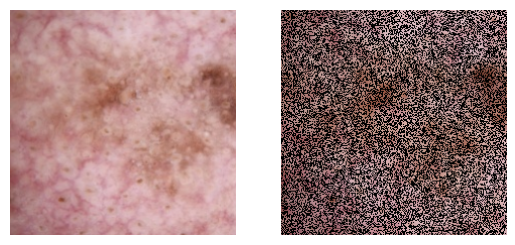

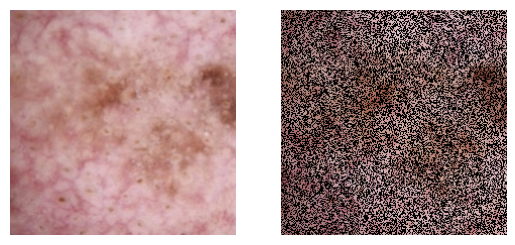

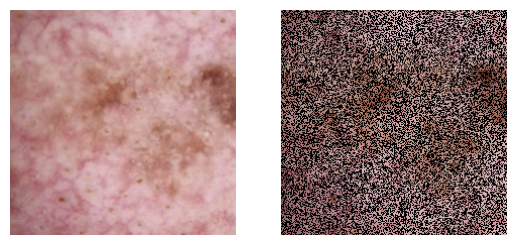

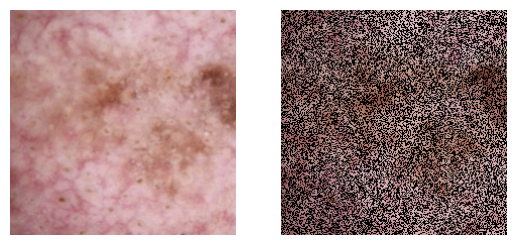

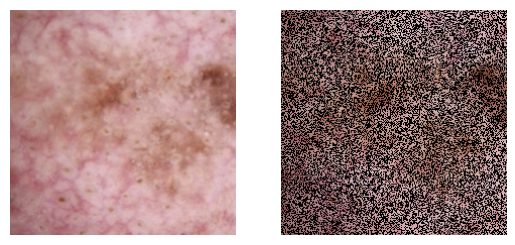

...

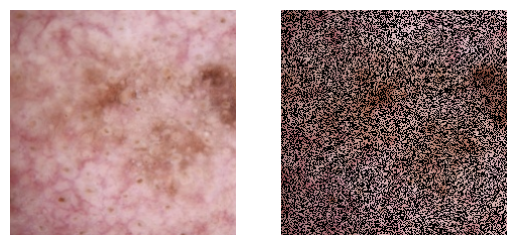

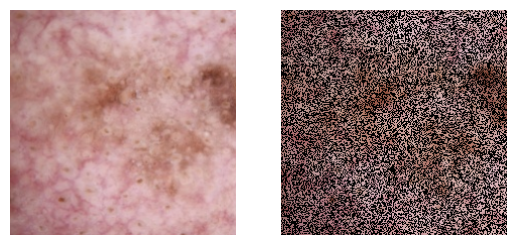

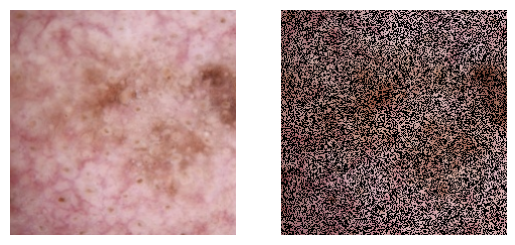

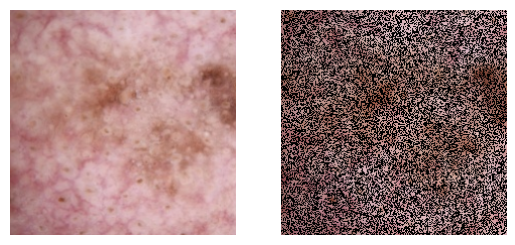

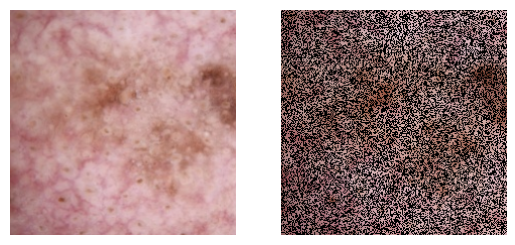

(224, 224)


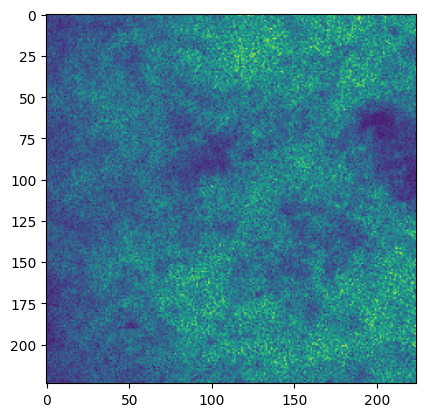

In [ ]:
for i in range(0, 32, 5):
  run(i)

In [ ]:
X, Y = train_datagen[0]
print(X.shape, Y.shape)

(32, 224, 224, 3) (32, 7)


1 0


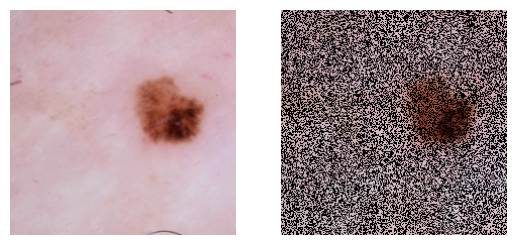

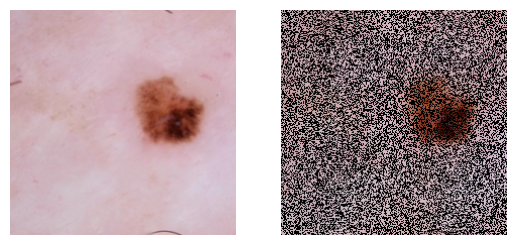

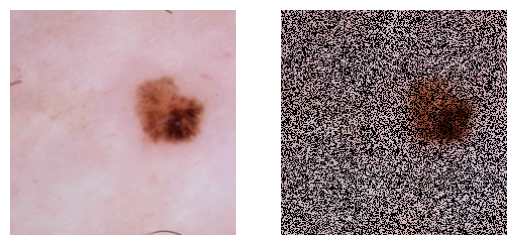

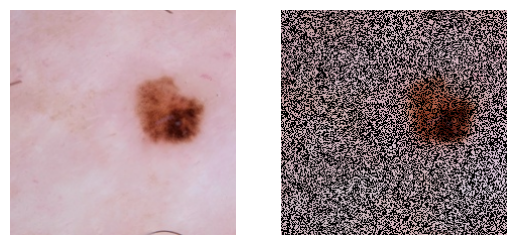

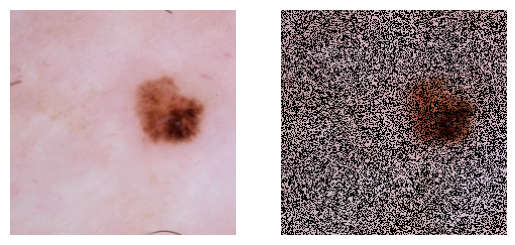

...

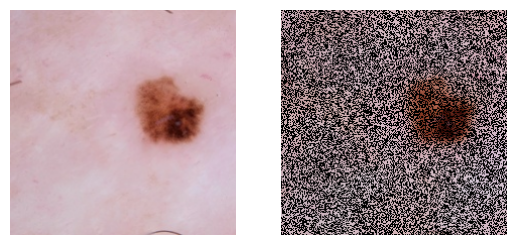

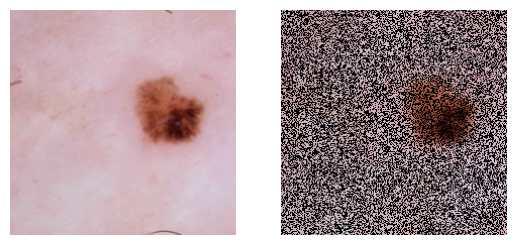

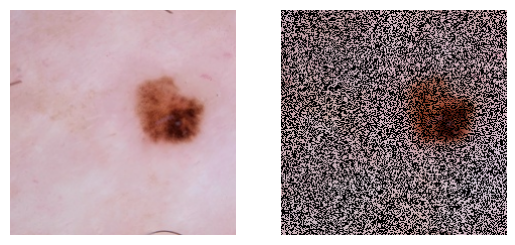

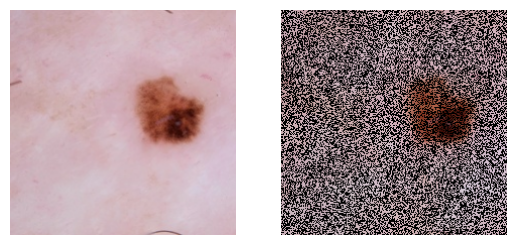

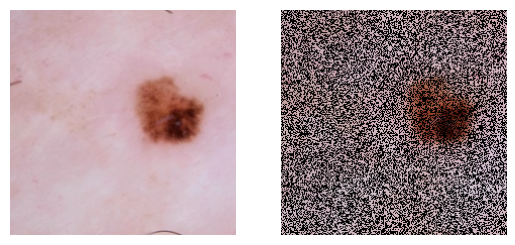

(224, 224)


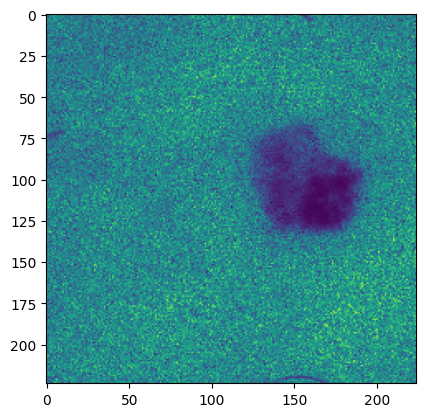

In [ ]:
run(1)